# 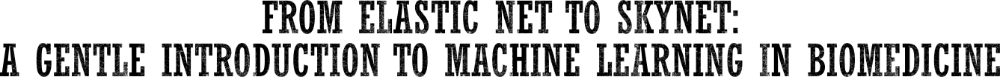

### *Tamas Spisak*,

PNI-Lab https://pni-lab.github.io/

tamas.spisak@uk-essen.de

# "From *Elastic Net* to *Skynet*"


## What we will talk about
- Elastic net and other machine learning methods
- The general philosophy beyond machine learning-based analyses 
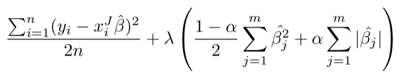

## What we will NOT talk about:


- "Skynet" from the Terminator movies
- Advanced machine learning models
- complex deep learning architectures
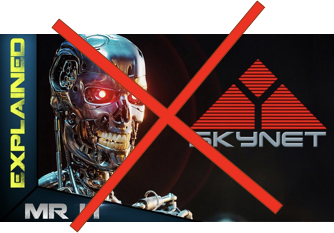

**Sorry for clickbaiting you!**

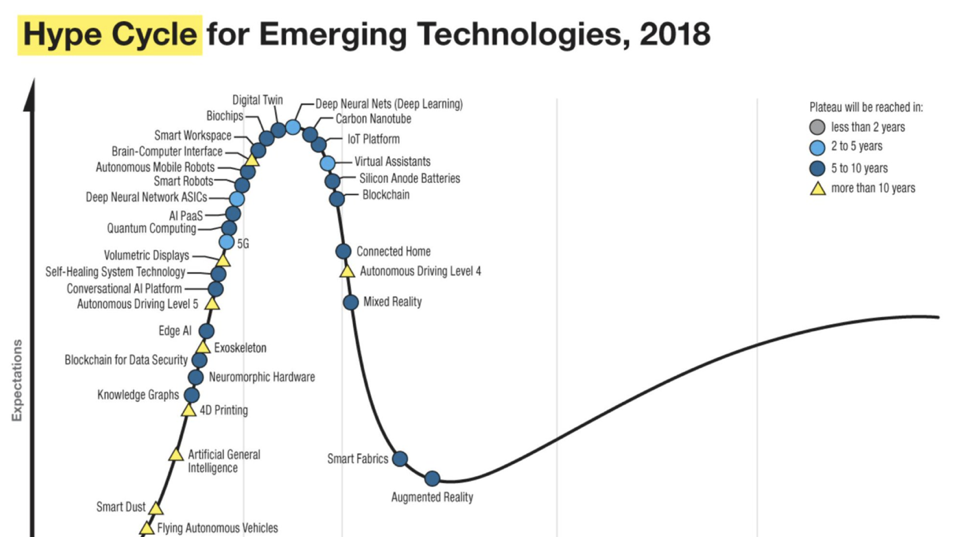

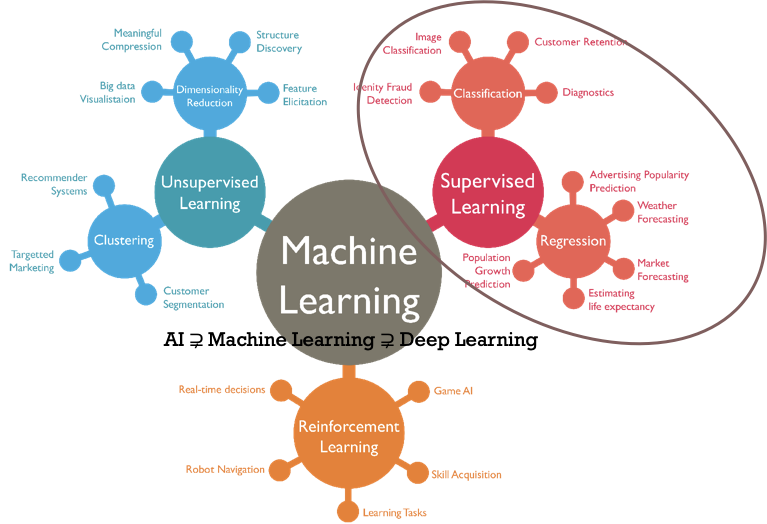

# AIM of this python Notebook:
- Establish a ground for understanding by refreshing your memories on linear regression
- Understand the difference between inference and prediction
- Demonstrate the problem of *overfitting*
- Understand the logic beyond cross validation
- Understand of how some classical machine learning methods can solve the issue of overfitting
- Overview of some simple machine learning techniques (neural networks, deep learning)
- Show a research example. 


# Python Notebook-based presentation

- figures are interactive
- source code is provided
- source code can be changed and run again on the fly
- feel free to interrupt the talk and patch the code if you have questions

Some technical details (not always shown in the slides).

In [1]:
# Imports and Co
import numpy as np
import pandas as pd
import plotly.io as pio
import plotly.figure_factory as ff

import plotly.offline as py #replaces import plotly.plotly as py
py.offline.init_notebook_mode()
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots

import teaching.teaching.plot as myplot

from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import LeaveOneOut
from sklearn.preprocessing import StandardScaler


# Set default renderer
pio.renderers.default = 'notebook+jupyterlab'  #  See [1]

# Set default template
pio.templates['slides'] = go.layout.Template(layout=dict(width=800, height=550))
pio.templates.default = 'plotly+slides'  # See [2]

In [2]:
df_full = pd.read_csv("../data/movie_metadata.csv")
df_full=df_full[['movie_title', 'title_year', 'budget', 'gross', 'imdb_score', 'duration', 'director_name', 'movie_facebook_likes',
      'facenumber_in_poster', 'actor_1_facebook_likes', 'actor_1_name']]
df=df_full[:100]
df

,movie_title,title_year,budget,gross,imdb_score,duration,director_name,movie_facebook_likes,facenumber_in_poster,actor_1_facebook_likes,actor_1_name
0,Avatar,2009.0,237000000.0,760505847.0,7.9,178.0,James Cameron,33000,0.0,1000.0,CCH Pounder
1,Pirates of the Caribbean: At World's End,2007.0,300000000.0,309404152.0,7.1,169.0,Gore Verbinski,0,0.0,40000.0,Johnny Depp
2,Spectre,2015.0,245000000.0,200074175.0,6.8,148.0,Sam Mendes,85000,1.0,11000.0,Christoph Waltz
3,The Dark Knight Rises,2012.0,250000000.0,448130642.0,8.5,164.0,Christopher Nolan,164000,0.0,27000.0,Tom Hardy
4,Star Wars: Episode VII - The Force Awakens ...,NaN,NaN,NaN,7.1,NaN,Doug Walker,0,0.0,131.0,Doug Walker
...,...,...,...,...,...,...,...,...,...,...,...
95,Guardians of the Galaxy,2014.0,170000000.0,333130696.0,8.1,121.0,James Gunn,96000,3.0,14000.0,Bradley Cooper
96,Interstellar,2014.0,165000000.0,187991439.0,8.6,169.0,Christopher Nolan,349000,1.0,11000.0,Matthew McConaughey
97,Inception,2010.0,160000000.0,292568851.0,8.8,148.0,Christopher Nolan,175000,0.0,29000.0,Leonardo DiCaprio
98,Godzilla Resurgence,2016.0,NaN,NaN,8.2,120.0,Hideaki Anno,0,0.0,544.0,Mark Chinnery


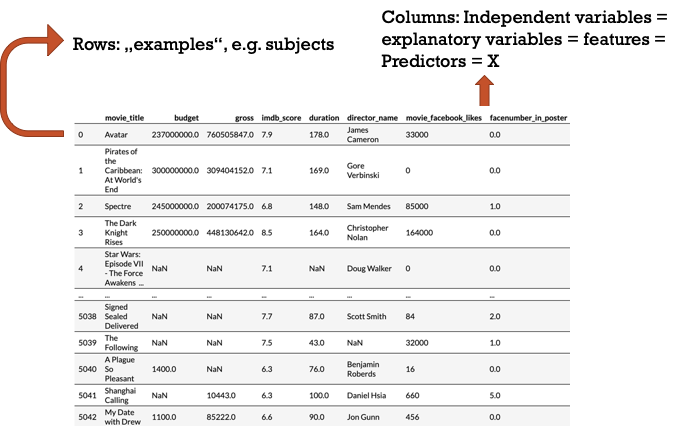

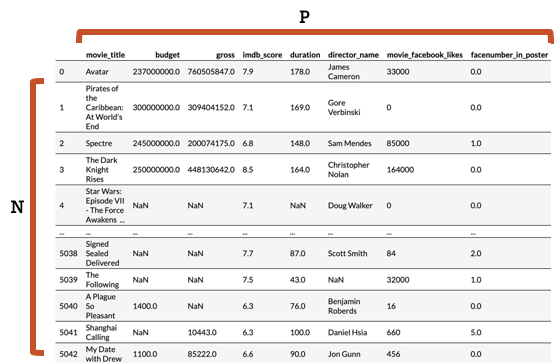

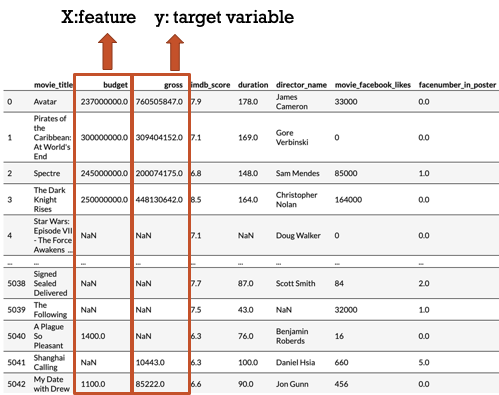

### Feature transformations

In [3]:
df = df.dropna()
fig = make_subplots(rows=1, cols=2)
fig.add_trace(go.Histogram(x=df["budget"], name="original"), row=1, col=1)
df['gross (log)']=np.log(df['gross'])
df['budget (log)']=np.log(df['budget'])
fig.add_trace(go.Histogram(x=df["budget (log)"], name="log transformed"), row=1, col=2)
fig.update_layout(title_text='Budget $', height=300)
fig.show()

## Can we predict the Gross income?

In [40]:
fig = px.scatter(df, x="budget", y="gross")
fig.update_layout(title_text='Budget $', height=400, width=600)
fig.show()

## A possible "prediction": movie will have "zero balance".

In [5]:
fig = myplot.plot_scatter_with_regline(df, x="budget", y="gross", legend=('movie', 'zero balance'))
fig.show()

## Better method: learn from the data!
### with linear regression

In [6]:
reg = LinearRegression().fit(X=df["budget"].values.reshape(-1,1), y=df["gross"])
print("Intercept:", reg.intercept_, "Slope:", reg.coef_)
print("Predicted income of a 1.000.000$ movie:", reg.predict(np.array([[1000000]])) )

Intercept: 13272267.359879732 Slope: [1.15009291]
Predicted income of a 1.000.000$ movie: [14422360.26858783]


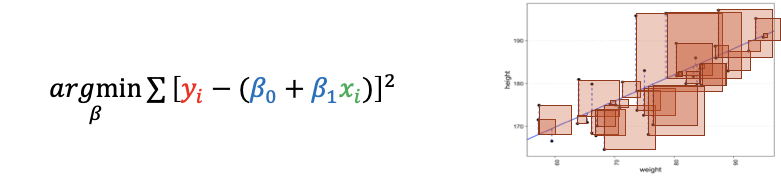

In [7]:
predicted = reg.intercept_ + reg.coef_*df["budget"]
#predicted = reg.predict(df["budget (log)"].values.reshape(-1,1))
fig = myplot.plot_scatter_with_regline(df, x="budget", y="gross",
                                       predicted=predicted, legend=('movie', 'linear fit'))
fig.show()


## Multiple explanatory variables (features)

In [8]:
df

,movie_title,title_year,budget,gross,imdb_score,duration,director_name,movie_facebook_likes,facenumber_in_poster,actor_1_facebook_likes,actor_1_name,gross (log),budget (log)
0,Avatar,2009.0,237000000.0,760505847.0,7.9,178.0,James Cameron,33000,0.0,1000.0,CCH Pounder,20.449494,19.283571
1,Pirates of the Caribbean: At World's End,2007.0,300000000.0,309404152.0,7.1,169.0,Gore Verbinski,0,0.0,40000.0,Johnny Depp,19.550159,19.519293
2,Spectre,2015.0,245000000.0,200074175.0,6.8,148.0,Sam Mendes,85000,1.0,11000.0,Christoph Waltz,19.114199,19.316769
3,The Dark Knight Rises,2012.0,250000000.0,448130642.0,8.5,164.0,Christopher Nolan,164000,0.0,27000.0,Tom Hardy,19.920595,19.336971
5,John Carter,2012.0,263700000.0,73058679.0,6.6,132.0,Andrew Stanton,24000,1.0,640.0,Daryl Sabara,18.106773,19.390323
...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,How to Train Your Dragon,2010.0,165000000.0,217387997.0,8.2,98.0,Dean DeBlois,33000,0.0,18000.0,Gerard Butler,19.197194,18.921456
94,Terminator 3: Rise of the Machines,2003.0,200000000.0,150350192.0,6.4,109.0,Jonathan Mostow,0,0.0,648.0,Nick Stahl,18.828478,19.113828
95,Guardians of the Galaxy,2014.0,170000000.0,333130696.0,8.1,121.0,James Gunn,96000,3.0,14000.0,Bradley Cooper,19.624045,18.951309
96,Interstellar,2014.0,165000000.0,187991439.0,8.6,169.0,Christopher Nolan,349000,1.0,11000.0,Matthew McConaughey,19.051907,18.921456


## Multiple Linear Regression

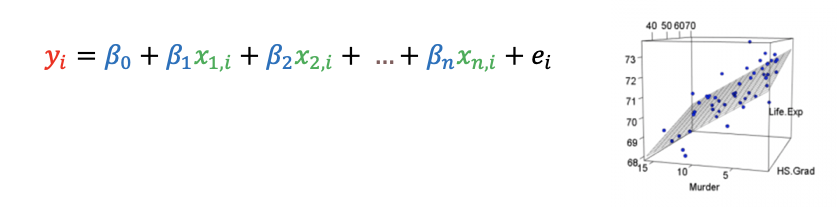

In [9]:
reg_multiple = LinearRegression().fit(X=df[['budget', 'duration', 'title_year', 'movie_facebook_likes']], y=df["gross"])
print("Intercept:", reg_multiple.intercept_)
print('            budget (log)', 'duration', '      title_year', '   movie_facebook_likes')
print("Slope:", reg_multiple.coef_)
print("Predicted income of a movie with:\n","budget=1.000.000$\n","duration: 120\n","year: 1996\n","likes: 100000\n",
     "=", reg_multiple.predict(np.array([[1000000, 120, 1996, 100000]])), "$" )

Intercept: 11314020477.806597
            budget (log) duration       title_year    movie_facebook_likes
Slope: [ 7.72701141e-01  1.16043649e+06 -5.67645594e+06  7.10696797e+02]
Predicted income of a movie with:
 budget=1.000.000$
 duration: 120
 year: 1996
 likes: 100000
 = [1.94909191e+08] $


In [10]:
predicted_multiple = reg_multiple.predict(df[['budget', 'duration', 'title_year', 'movie_facebook_likes']])
fig = myplot.plot_scatter_with_regpoints(df, x="budget", y="gross",
                                       predicted=predicted_multiple, legend=('movie', 'linear fit'))
fig.show()

## Predicted vs. Observed plots, prediction error

In [42]:
fig = make_subplots(rows=1, cols=2)
#fig.add_trace(go.Scatter(x=df['gross'], y=df['budget'], mode='markers', name="zero balance"), row=1, col=1)
#fig.add_trace(go.Scatter(x=df['gross'], y=df['gross'], mode='lines', name="perfect prediction"), row=1, col=1)
fig.add_trace(go.Scatter(x=df['gross'], y=predicted, mode='markers', name="budget only"), row=1, col=1)
#fig.add_trace(go.Scatter(x=df['gross'], y=df['gross'], mode='lines', name="perfect prediction"), row=1, col=2)
fig.add_trace(go.Scatter(x=df['gross'], y=predicted_multiple, mode='markers', name="budget+dur+title+like"), row=1, col=2)
#fig.add_trace(go.Scatter(x=df['gross'], y=df['gross'], mode='lines', name="perfect prediction"), row=1, col=3)
fig.update_layout(title_text='Predicted vs. Observed', height=400)

In [43]:
fig.show()

In [13]:
print("MSE:", mean_squared_error(df["gross"], predicted), mean_squared_error(df["gross"], predicted_multiple))

MSE: 1.8735203850871804e+16 1.6075887205962612e+16


## Prediction error improved as we added more features

- why not adding many features?

- Lets do an experiment: add many random features

In [14]:
def simulate(n_random):
 return np.hstack((df['budget'].values.reshape(95,1), np.random.normal(0,1,(len(df['budget'].values), int(n_random)))))

mse=[]
for i, num_rand in enumerate(np.linspace(0, 79, 80)):
    X=simulate(num_rand)
    reg_random = LinearRegression().fit(X=X, y=df["gross"])
    mse.append(mean_squared_error(df["gross"], reg_random.predict(X)))
    if i%10 == 0: print(mse[i])

1.8735203850871804e+16
1.5951112549429728e+16
1.5969162971585426e+16
1.0882767342958106e+16
1.2576744144136294e+16
7765277294597943.0
6717662745553190.0
6218272550795730.0


In [15]:
fig = px.scatter(x=np.linspace(0, 79, 80), y=mse, trendline="ols", labels={'x':'num random variables', 'y':'MSE'})
fig.show()

## What on earth is happening?

- More explanatory variables -> more beta values to set
- A model with a sufficient number of (beta) parameters is able to "learn" the data at hand, instead of the relationship

**BUT:**
- Such a model will not generalise to new data
- Predictive power will be low


This is called:

## Overfitting

### Another example: adding ith degree of the variable

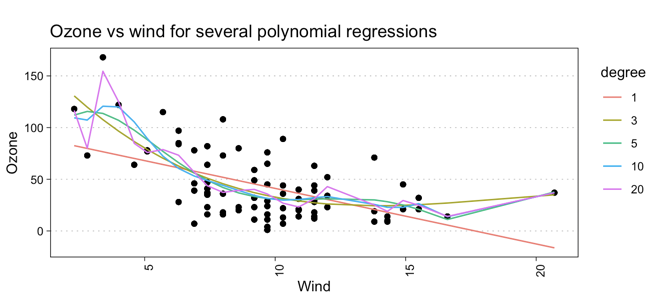

## Real examples of overfitting

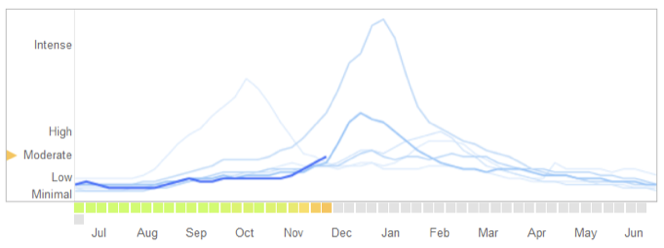
Google Flu Trends in 2009

## Real examples of overfitting
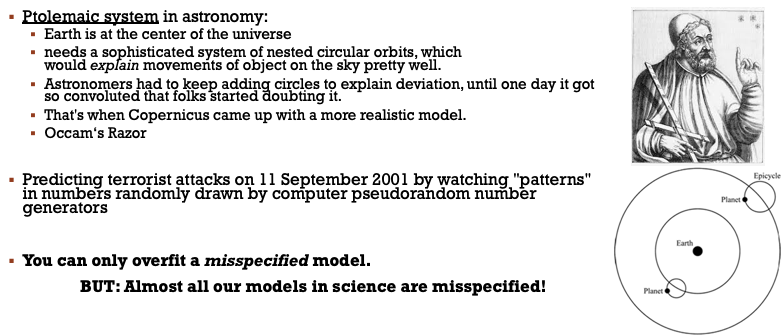

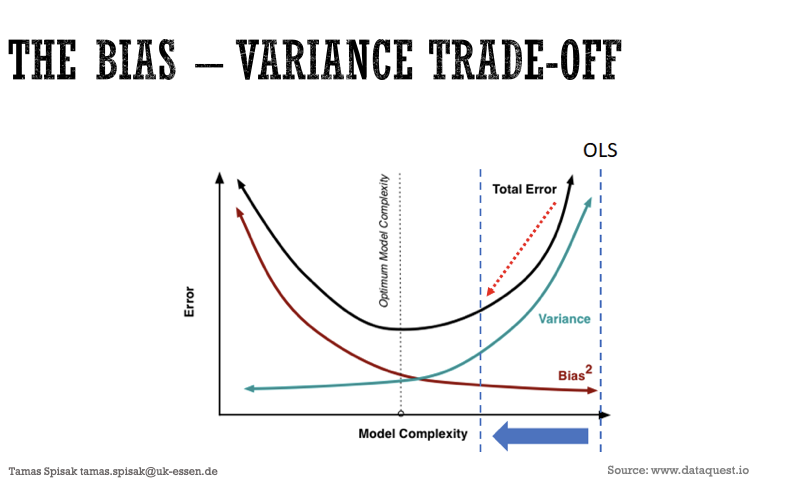

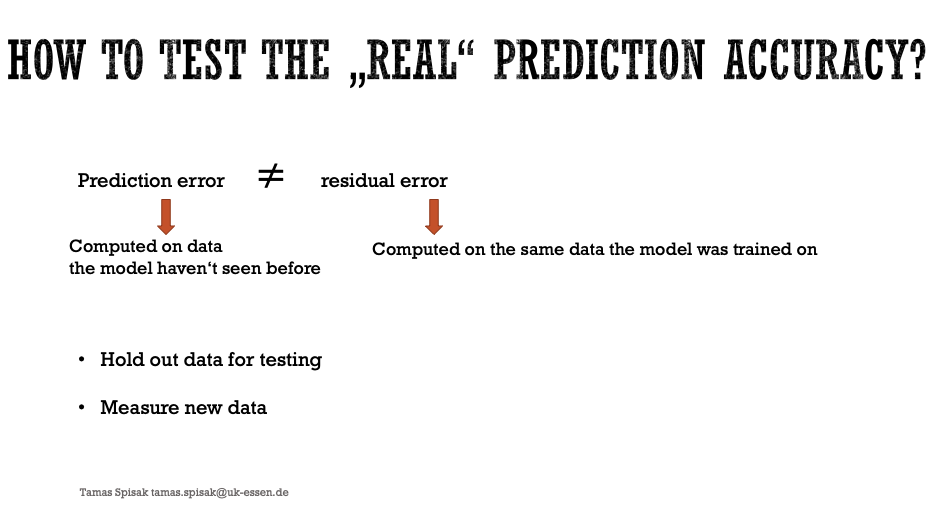

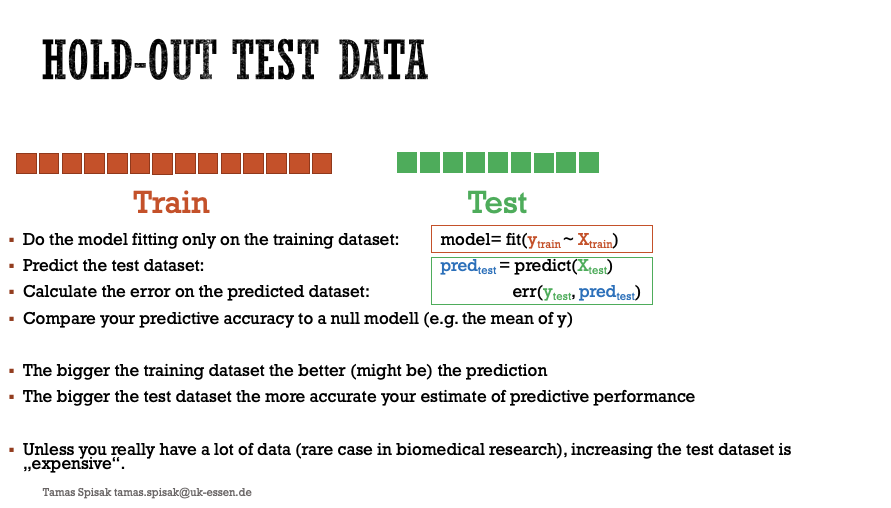

## RMS of models random variables on hold out data

In [16]:
df_train = df
df_test = df_full[100:200]
df_test = df_test.dropna()

def simulate(df, n_random):
 return np.hstack((df['budget'].values.reshape(len(df),1), np.random.normal(0,1,(len(df['budget'].values), int(n_random)))))

mse_train, mse_test = [], []
for i, num_rand in enumerate(np.linspace(0, 79, 80)):
    X_train=simulate(df_train, num_rand)
    reg_random = LinearRegression().fit(X=X_train, y=df["gross"])
    X_test=simulate(df_test, num_rand)
    mse_test.append(mean_squared_error(df_test["gross"], reg_random.predict(X_test)))
    if i%10 == 0: print(mse_test[i])


8213231283239565.0
8781533897131713.0
9277413394769886.0
1.2986380926620672e+16
2.285021879973118e+16
5.96817173033784e+16
3.652101490295798e+16
3.2581501009925476e+16


In [17]:
fig = make_subplots(rows=1, cols=2)
fig.add_trace(go.Scatter(x=np.linspace(0, 79, 80), y=mse, mode='markers', name="MSE on train"), row=1, col=1)
fig.add_trace(go.Scatter(x=np.linspace(0, 79, 80), y=mse_test, mode='markers', name="MSE on test"), row=1, col=2)
fig.update_layout(title_text='Adding random variables', height=300)
fig.show()

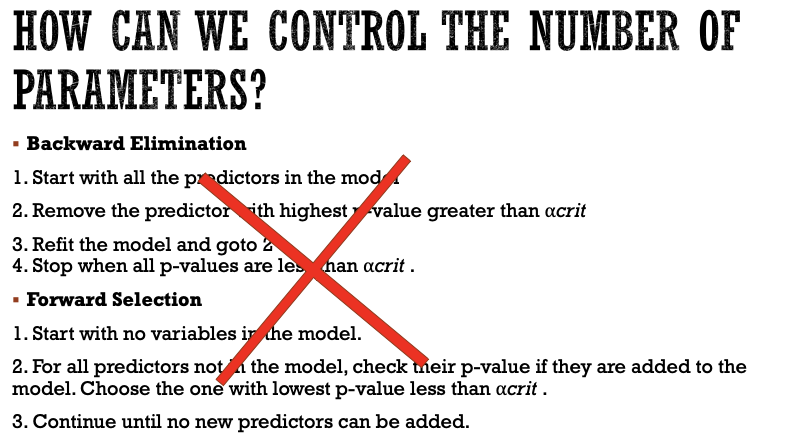

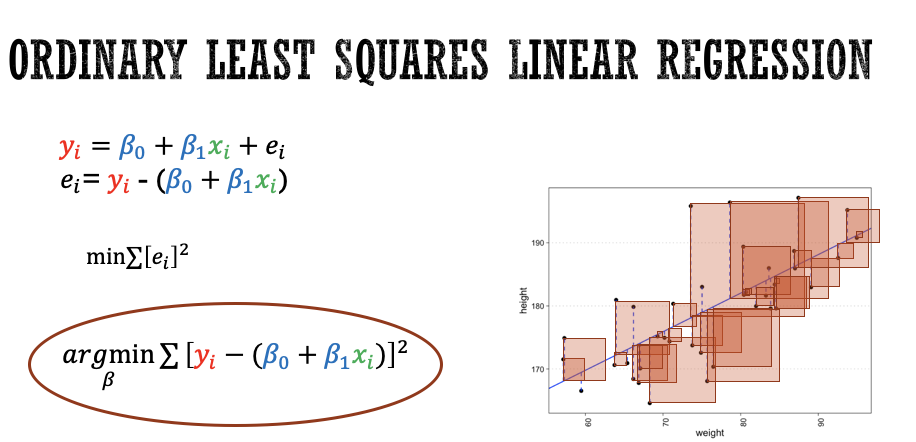

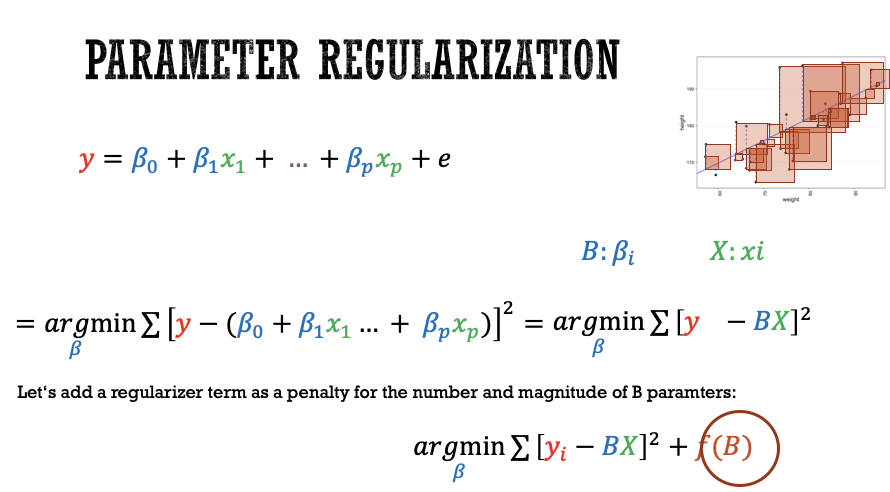

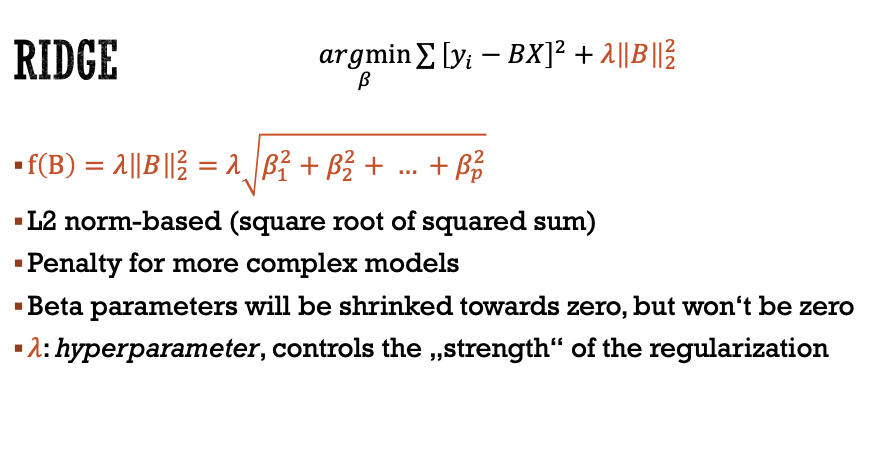

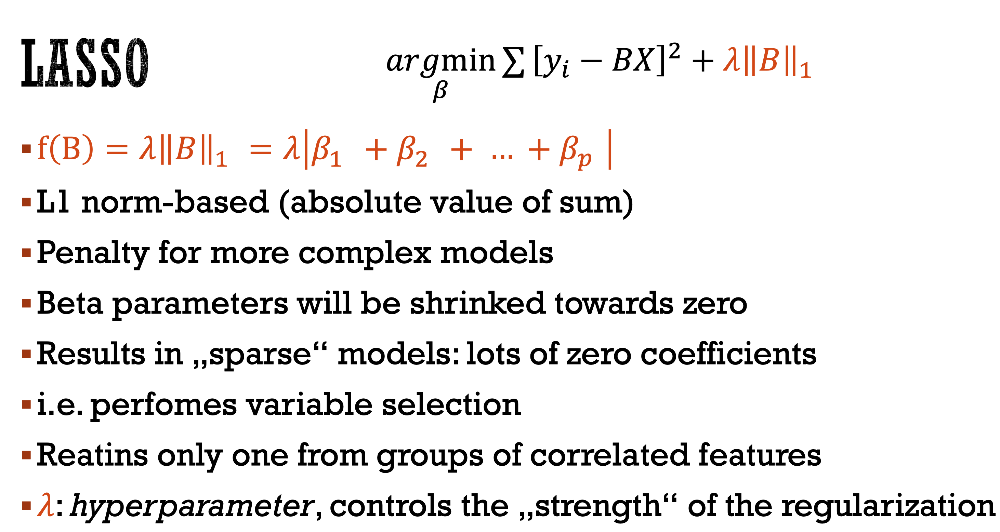

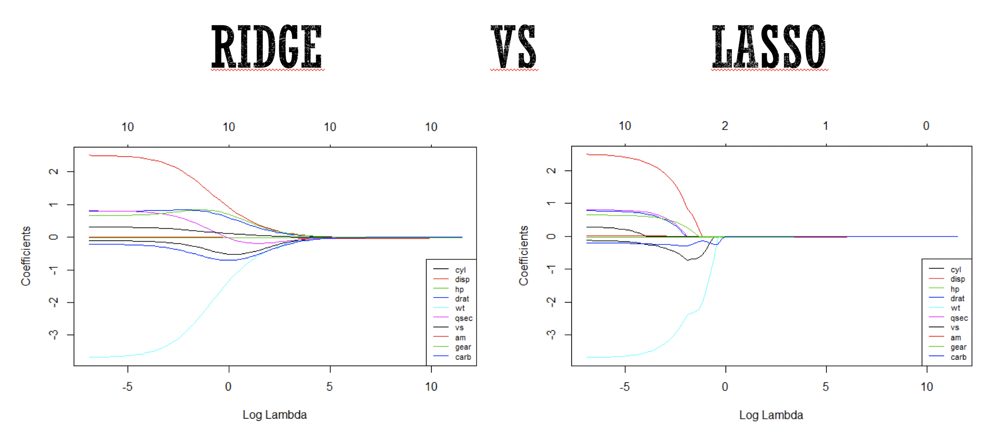

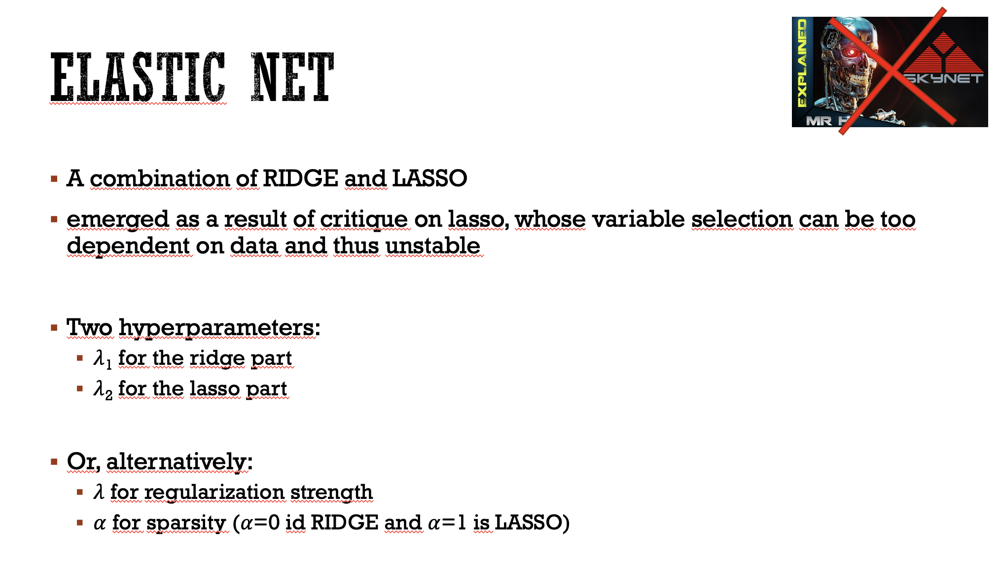

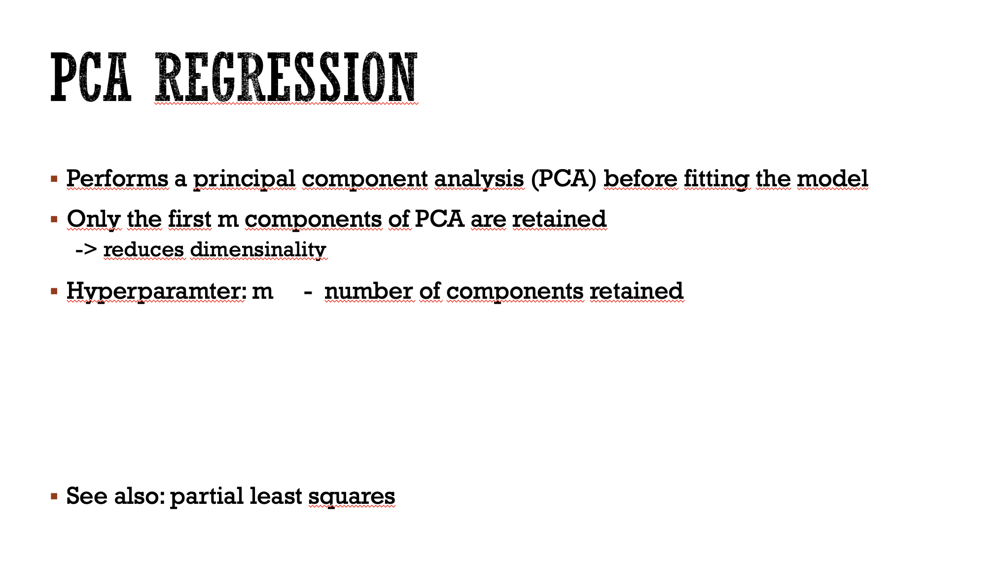

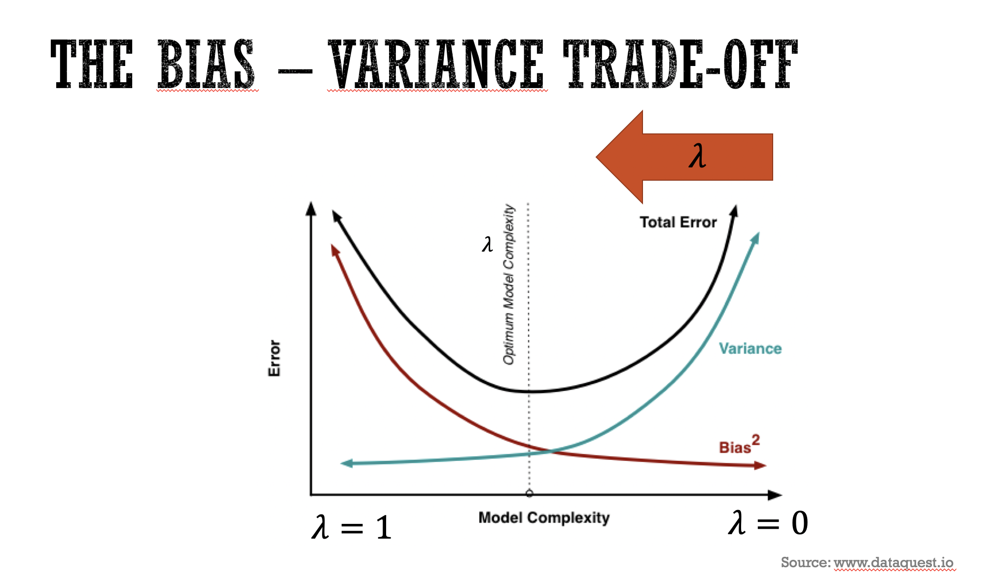

# How can we know what is the optimal lambda?

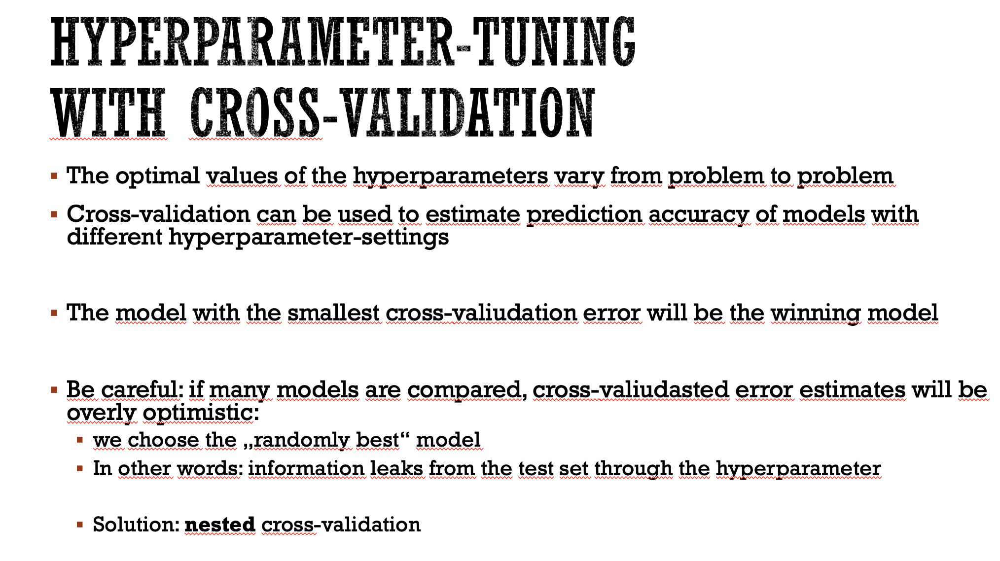

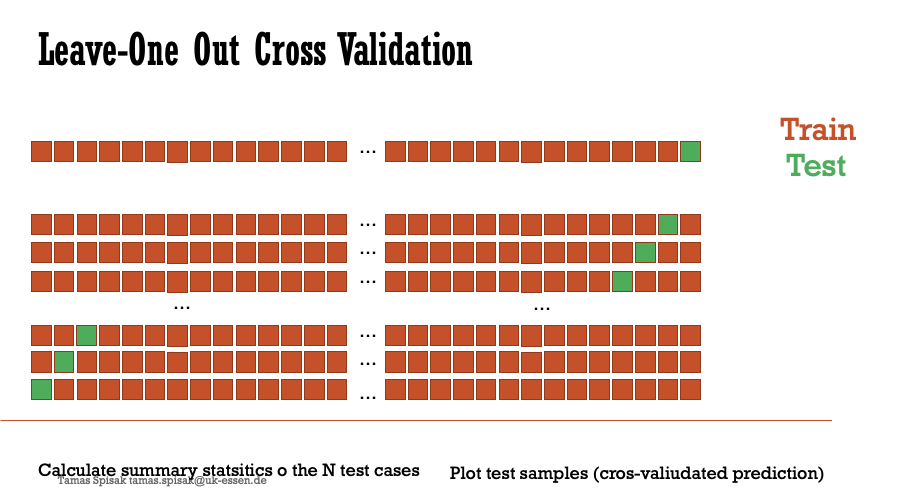

In [18]:
loo=LeaveOneOut()
for train, test in loo.split(df):
    print('train:', train)
    print('test: ', test)


train: [ 1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
test:  [0]
train: [ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
test:  [1]
train: [ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72
 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94]
test:  [2]
train: [ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 2

## Ridge

In [19]:
def simulate(df, n_random):
    # here with scaling
    budget = StandardScaler().fit_transform(df['budget'].values.reshape(-1,1))
    return np.hstack((budget, np.random.normal(0,1,(len(df['budget'].values), int(n_random)))))


In [20]:
X = simulate(df, 10)
y = StandardScaler().fit_transform(df["gross"].values.reshape(-1,1))
alphas = [1, 5, 50, 100]
mse=np.zeros((loo.get_n_splits(df), len(alphas)))
idx=0             
for train, test in loo.split(df):
    for i, alpha in enumerate(alphas):
        ridge = Ridge(alpha=alpha).fit(X=X[train], y=y[train])
        mse[idx, i] = mean_squared_error(ridge.predict(X[test]), y[test]) 
    idx += 1

pd.DataFrame(mse, columns=alphas).mean()

1      1.101940
5      1.086865
50     1.016861
100    1.000865
dtype: float64

In [21]:
print(Ridge(alpha=1).fit(X=X, y=y).coef_.round(3).tolist())
print(Ridge(alpha=5).fit(X=X, y=y).coef_.round(3).tolist())
print(Ridge(alpha=50).fit(X=X, y=y).coef_.round(3).tolist())
print(Ridge(alpha=100).fit(X=X, y=y).coef_.round(3).tolist())

[[0.274, 0.134, -0.057, -0.172, -0.006, 0.095, 0.005, 0.03, -0.101, -0.1, 0.089]]
[[0.261, 0.129, -0.057, -0.164, -0.005, 0.086, 0.004, 0.027, -0.098, -0.097, 0.086]]
[[0.172, 0.09, -0.051, -0.108, -0.003, 0.041, -0.003, 0.012, -0.069, -0.073, 0.063]]
[[0.126, 0.068, -0.042, -0.079, -0.003, 0.025, -0.005, 0.006, -0.052, -0.057, 0.048]]


## LASSO

In [25]:
np.random.seed(1)
X = simulate(df, 10)
y = StandardScaler().fit_transform(df["gross"].values.reshape(-1,1))
alphas = [0.0001, 0.001, 0.01, 0.1, 0.2]
mse=np.zeros((loo.get_n_splits(df), len(alphas)))
idx=0             
for train, test in loo.split(df):
    for i, alpha in enumerate(alphas):
        lasso = Lasso(alpha=alpha).fit(X=X[train], y=y[train])
        mse[idx, i] = mean_squared_error(lasso.predict(X[test]), y[test]) 
    idx += 1
pd.DataFrame(mse, columns=alphas).mean()

0.0001    1.129391
0.0010    1.126869
0.0100    1.105757
0.1000    1.019925
0.2000    1.016580
dtype: float64

In [26]:
np.random.seed(1)
print(Lasso(alpha=0.0001).fit(X=X, y=y).coef_.tolist())
print(Lasso(alpha=0.001).fit(X=X, y=y).coef_.tolist())
print(Lasso(alpha=0.01).fit(X=X, y=y).coef_.tolist())
print(Lasso(alpha=0.1).fit(X=X, y=y).coef_.tolist())
print(Lasso(alpha=0.2).fit(X=X, y=y).coef_.tolist())

[0.23904693126987822, 0.11311961638819269, -0.1205819815237522, -0.08628750307776789, 0.03060487698817424, 0.05616830675138726, -0.02244606000275336, 0.0723120221172578, -0.13492654149901795, 0.012957912499661595, -0.030961141999299467]
[0.23824043336472084, 0.11228332550654646, -0.12010006145432835, -0.08554307574073178, 0.029439889371221876, 0.05568986734889118, -0.021920765244540587, 0.07166039968028587, -0.13377376126947238, 0.012117282714558933, -0.030314045106798415]
[0.23022191574931788, 0.10393943373990454, -0.11527169337455904, -0.07811728313497565, 0.017779942267302746, 0.0508752318840866, -0.016671052130229888, 0.06516269194505794, -0.12223029751409578, 0.003691931132595483, -0.023849014842773263]
[0.14635111394363445, 0.03088923484574456, -0.06018659273146955, -0.0, 0.0, 0.009567788842493468, -0.0, 0.0, -0.013280684061440314, 0.0, -0.0]
[0.05635304363919125, 0.0, -0.0, -0.0, 0.0, 0.0, -0.0, 0.0, -0.0, 0.0, -0.0]


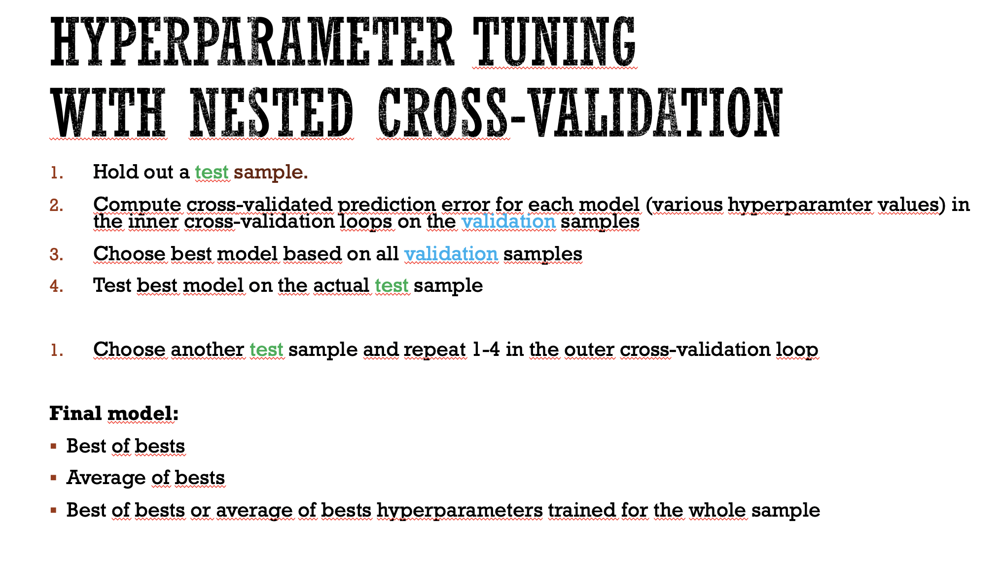

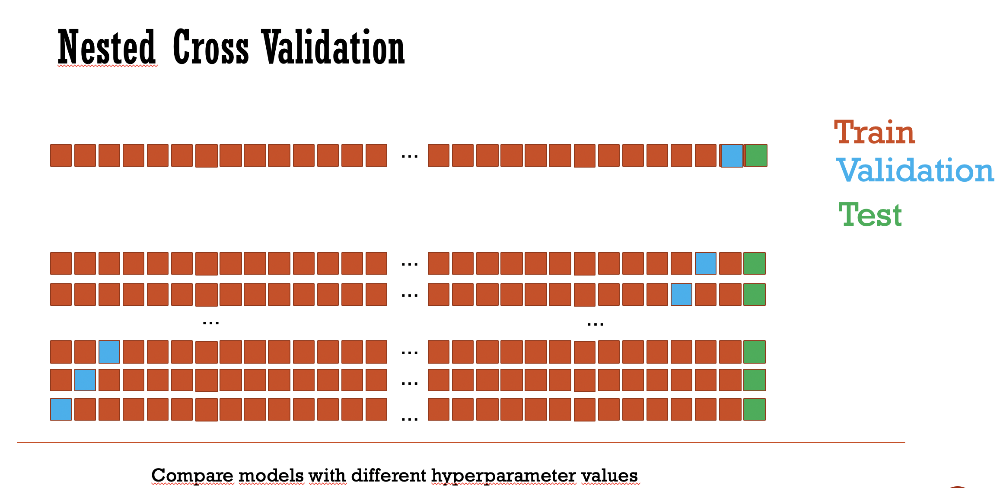

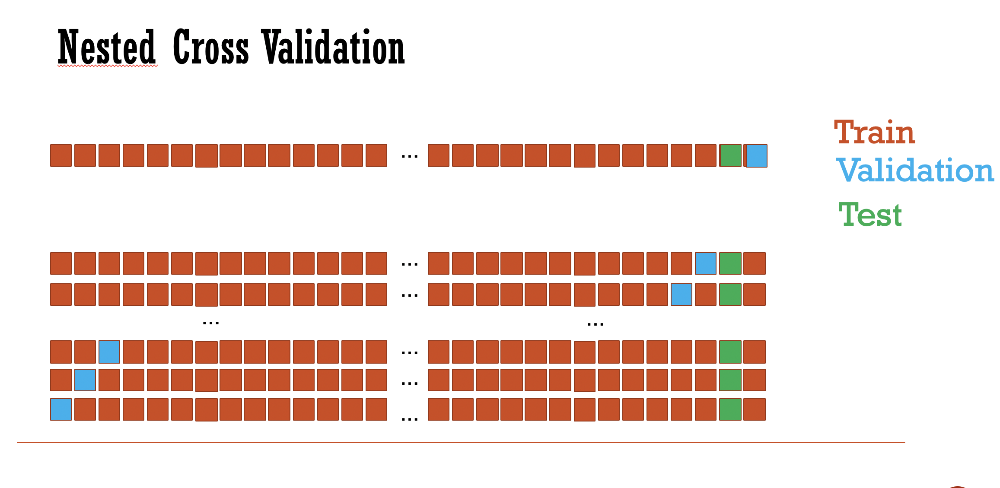

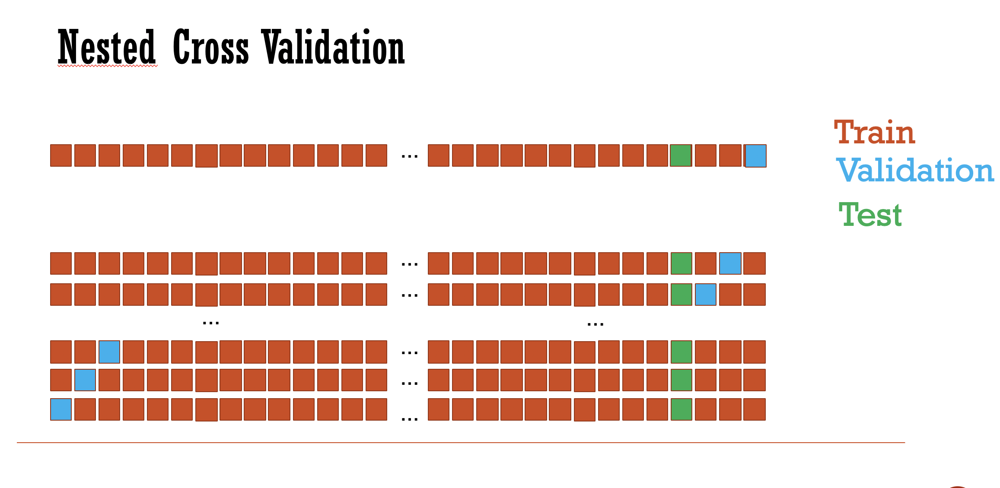

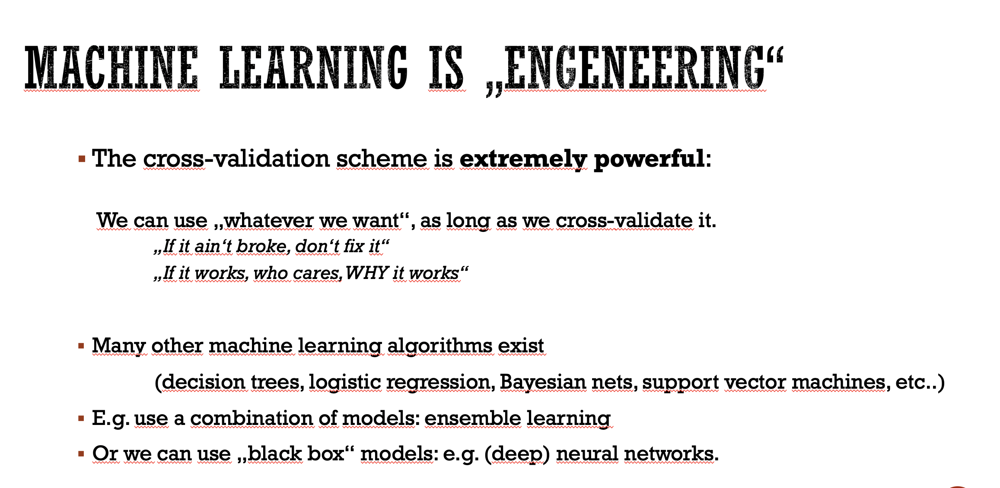

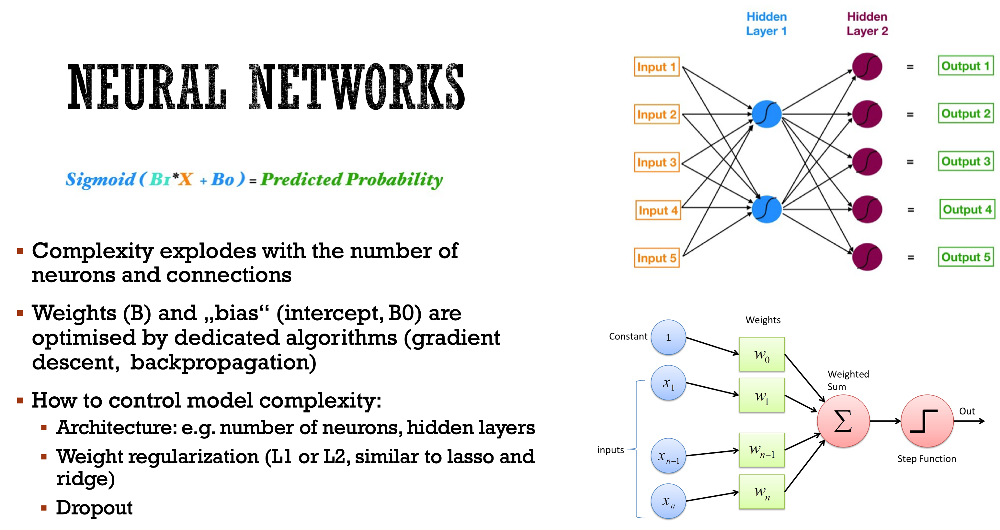

In [28]:
import tensorflow as tf
from tensorflow import keras

def preprocess(x, y):
  x = tf.cast(x, tf.float32) / 255.0
  y = tf.cast(y, tf.int64)

  return x, y

def create_dataset(xs, ys, n_classes=10):
  ys = tf.one_hot(ys, depth=n_classes)
  return tf.data.Dataset.from_tensor_slices((xs, ys)) \
    .map(preprocess) \
    .shuffle(len(ys)) \
    .batch(128)

# get data
(x_train, y_train), (x_val, y_val) = keras.datasets.fashion_mnist.load_data()
train_dataset = create_dataset(x_train, y_train)
val_dataset = create_dataset(x_val, y_val)

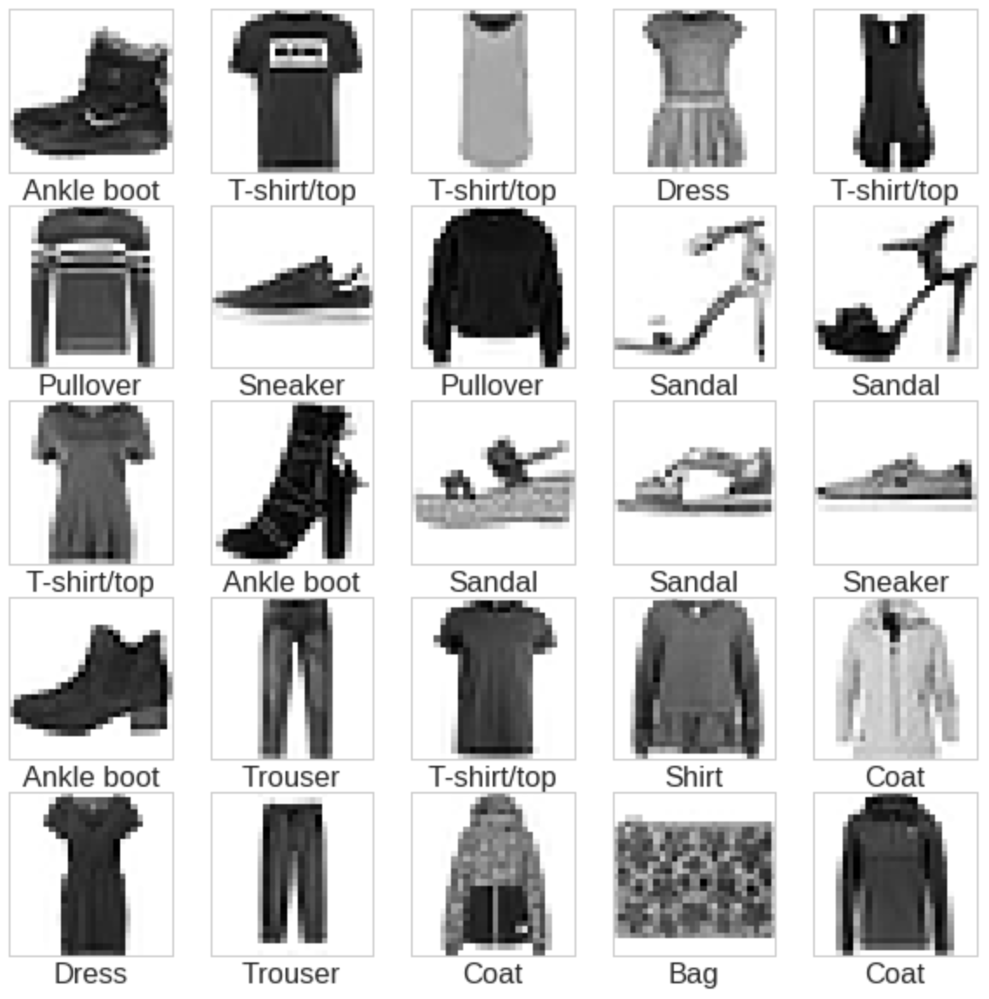

In [34]:
# set up 
model = keras.Sequential([
    keras.layers.Reshape(target_shape=(28 * 28,), input_shape=(28, 28)),
    keras.layers.Dense(units=256, activation='relu'),
    keras.layers.Dense(units=192, activation='relu'),
    keras.layers.Dense(units=128, activation='relu'),
    keras.layers.Dense(units=10, activation='softmax')
])

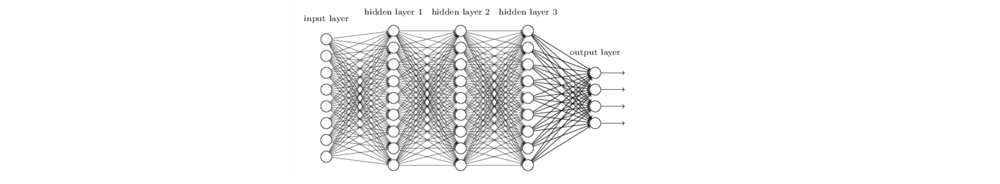

In [35]:
model.compile(optimizer='adam', 
              loss=tf.losses.CategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

history = model.fit(
    train_dataset.repeat(), 
    epochs=5, 
    steps_per_epoch=200,
    validation_data=val_dataset.repeat(), 
    validation_steps=2
)

Train for 200 steps, validate for 2 steps
Epoch 1/5
200/200 [==============================] - 5s 27ms/step - loss: 1.7383 - accuracy: 0.7336 - val_loss: 1.6336 - val_accuracy: 0.8398
Epoch 2/5
200/200 [==============================] - 2s 8ms/step - loss: 1.6668 - accuracy: 0.7963 - val_loss: 1.6832 - val_accuracy: 0.7812
Epoch 3/5
200/200 [==============================] - 4s 21ms/step - loss: 1.6588 - accuracy: 0.8033 - val_loss: 1.6215 - val_accuracy: 0.8398
Epoch 4/5
200/200 [==============================] - 2s 8ms/step - loss: 1.6564 - accuracy: 0.8052 - val_loss: 1.6320 - val_accuracy: 0.8281
Epoch 5/5
200/200 [==============================] - 5s 23ms/step - loss: 1.6351 - accuracy: 0.8265 - val_loss: 1.6452 - val_accuracy: 0.8203


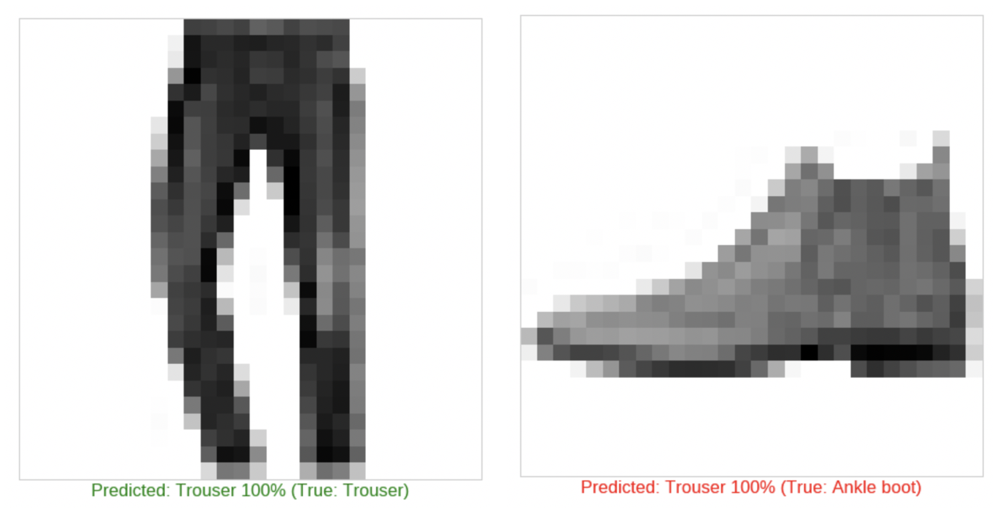

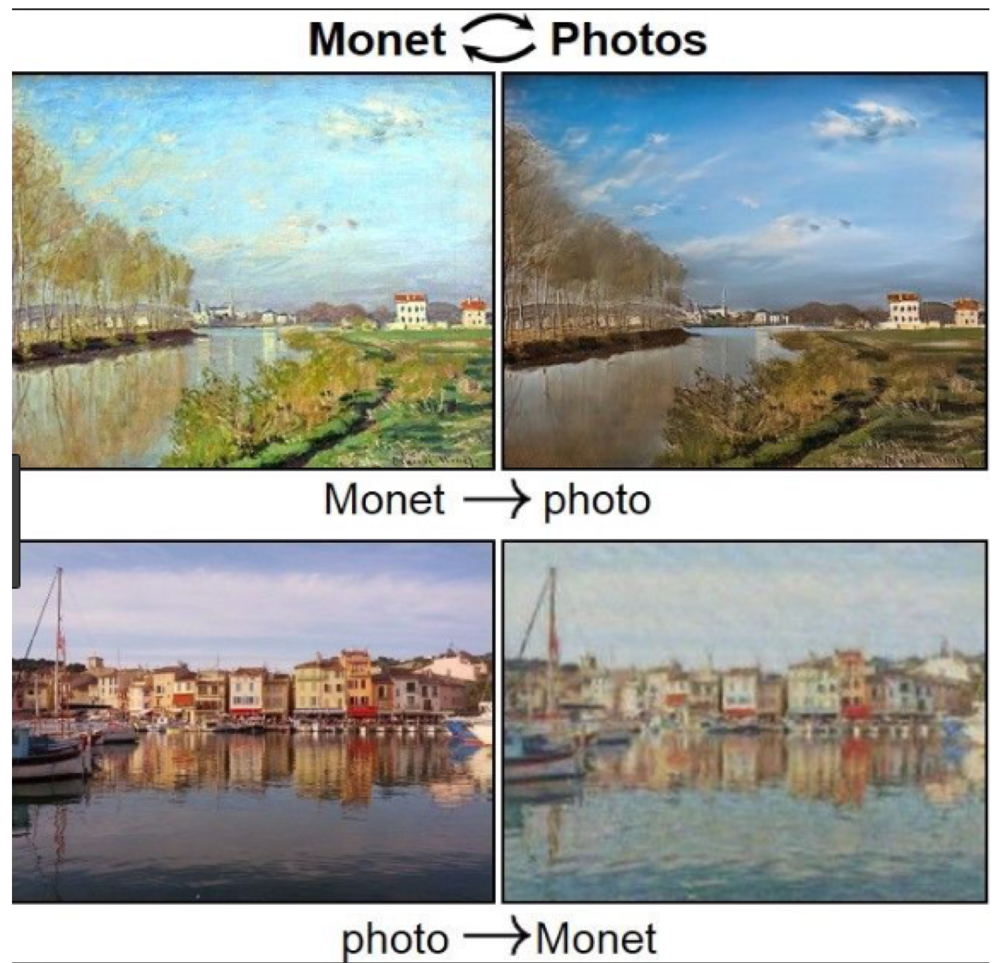

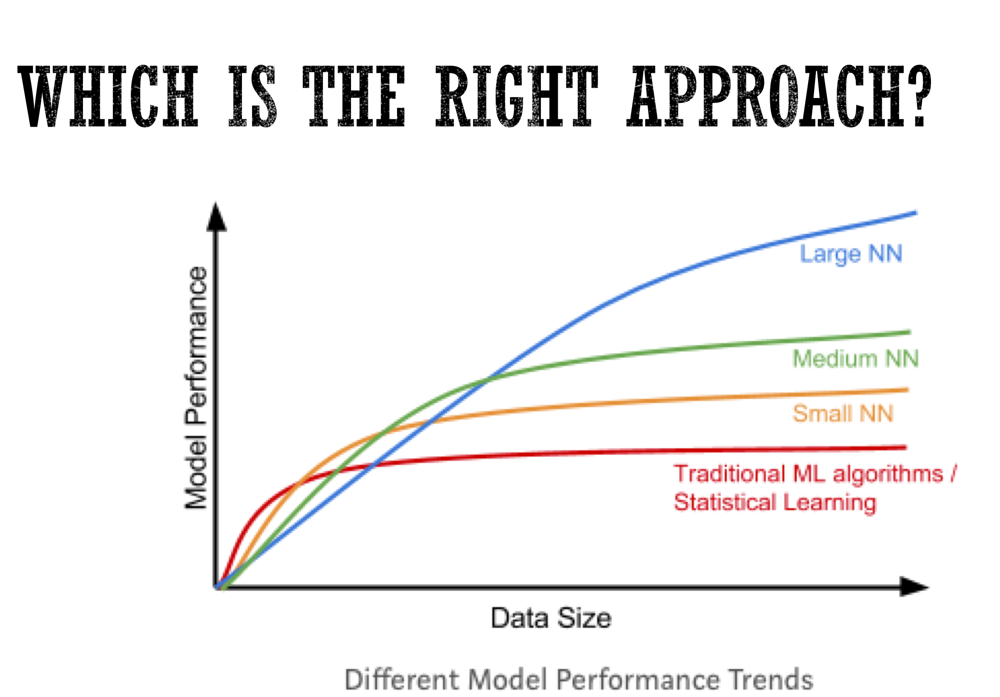

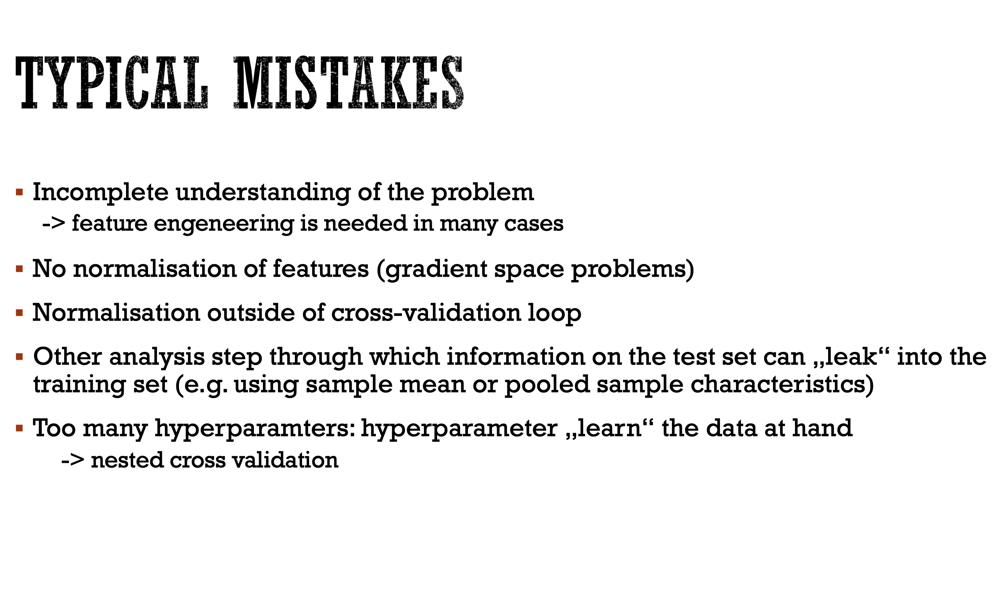

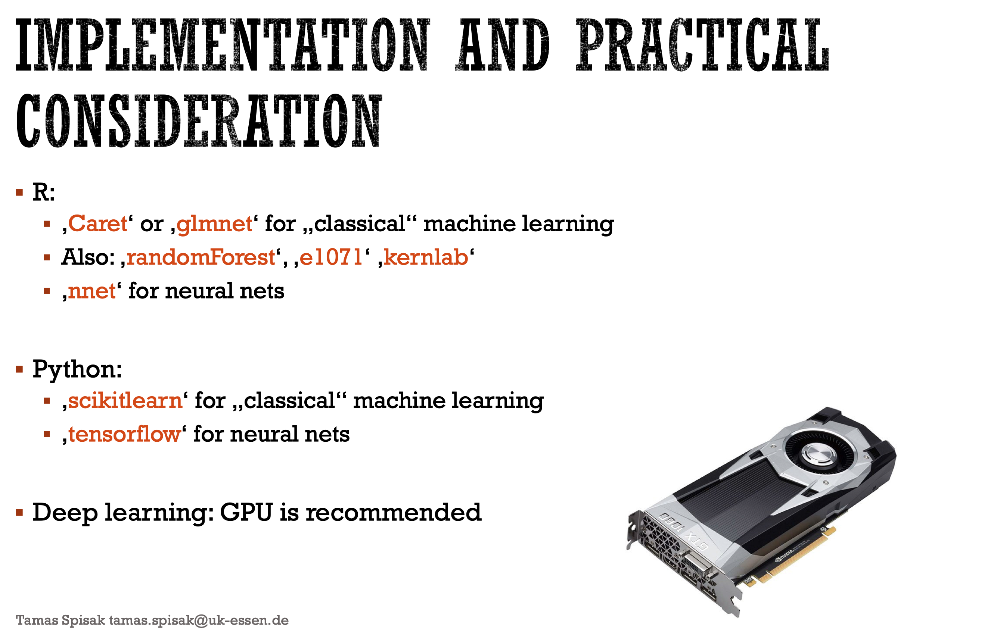

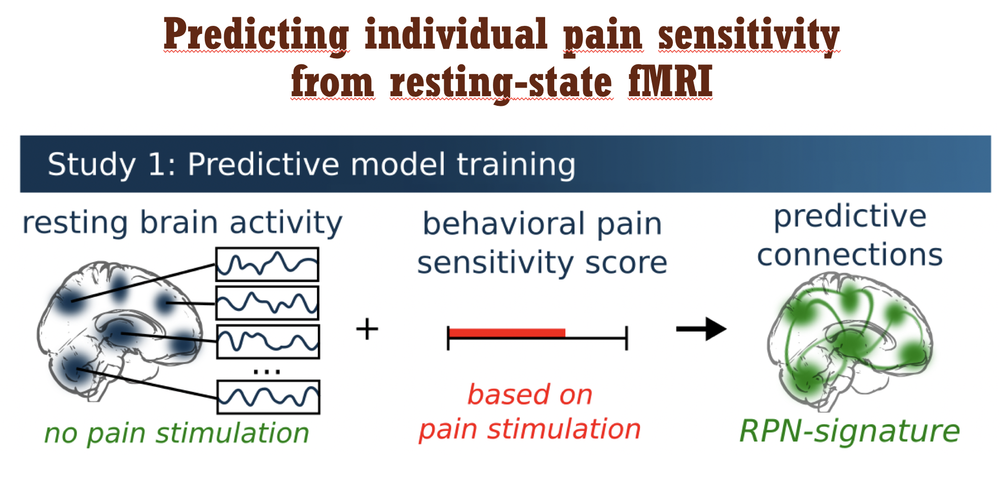

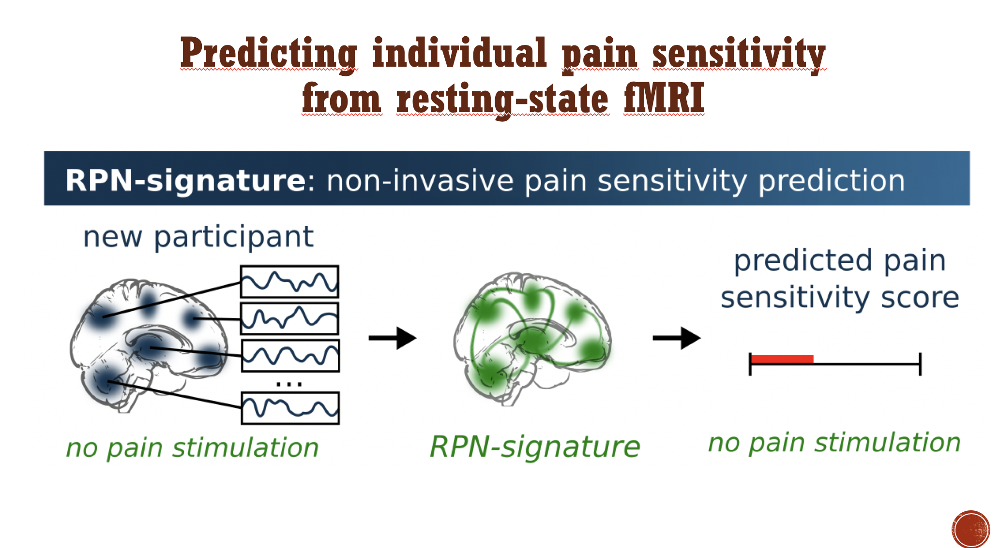

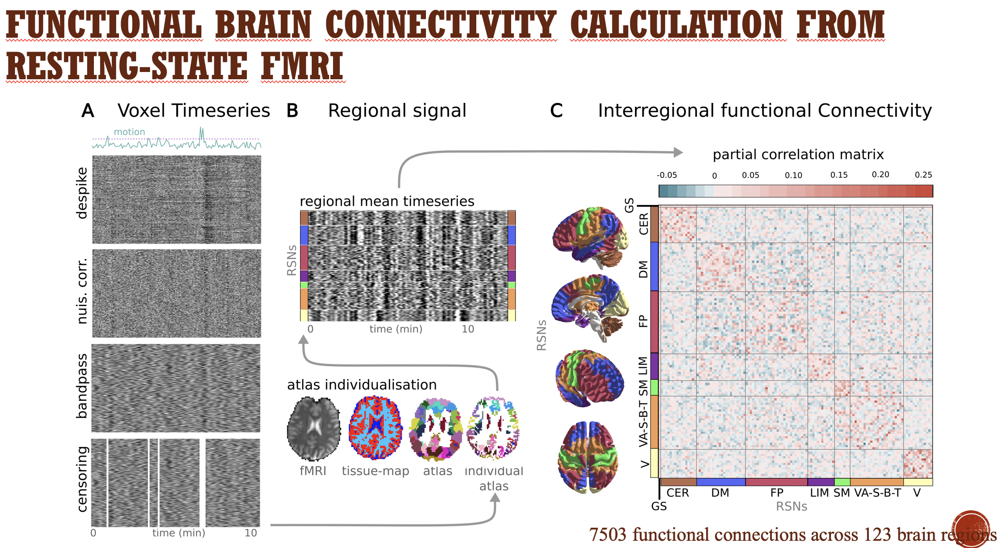

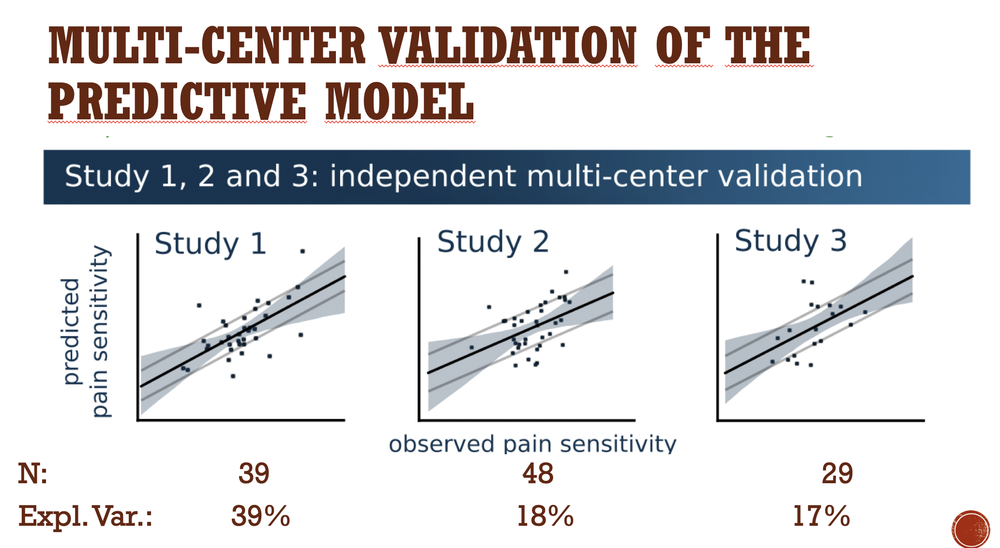

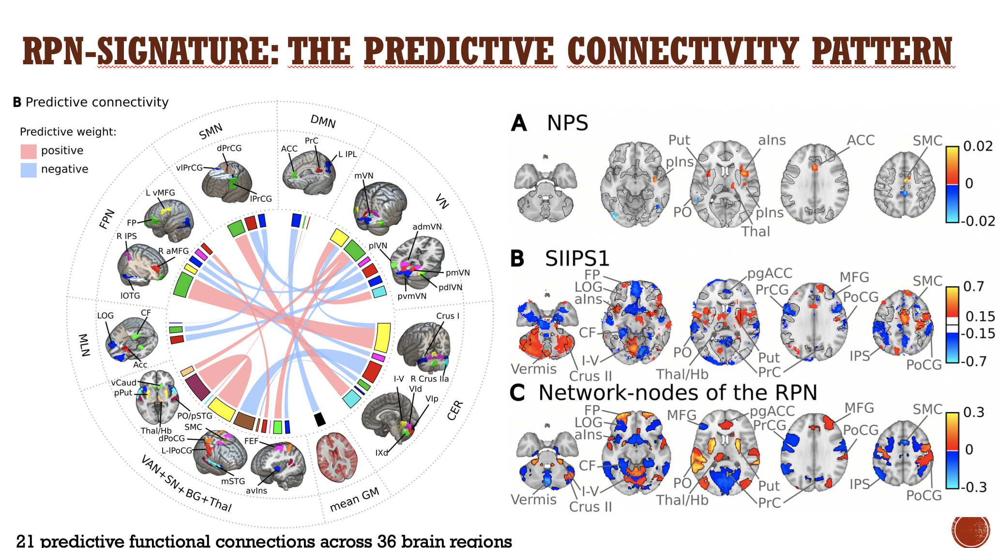